<a href="https://colab.research.google.com/github/Alphy2194/AlfonceProject/blob/master/AlphyModelling_And_Simulation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
!pip install pandasql


In [5]:
# Set up modules/libraries
import pandas as pd
import numpy as np
from pandasql import sqldf
import plotly.express as px
sql = lambda q: sqldf(q, globals())

# Data Viz libraries
import matplotlib.pyplot as plt # basic plotting
import seaborn as sns # for prettier plots
import plotly.graph_objects as go

# Config plot style sheets
# https://matplotlib.org/3.1.0/gallery/style_sheets/style_sheets_reference.html
plt.style.use('fivethirtyeight')
pd.plotting.register_matplotlib_converters()

# suppress warnings
import warnings
warnings.filterwarnings("ignore")

In [6]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:
from google.colab import files
uploaded = files.upload()


Saving weatherHistory.csv to weatherHistory (2).csv


In [8]:
import pandas as pd
weather_AU = pd.read_csv('weatherHistory.csv')


In [9]:
weather_AU.head(5)

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),Daily Summary
0,2006-04-01 00:00:00.000 +0200,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251.0,15.8263,0.0,1015.13,Partly cloudy throughout the day.
1,2006-04-01 01:00:00.000 +0200,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259.0,15.8263,0.0,1015.63,Partly cloudy throughout the day.
2,2006-04-01 02:00:00.000 +0200,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204.0,14.9569,0.0,1015.94,Partly cloudy throughout the day.
3,2006-04-01 03:00:00.000 +0200,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269.0,15.8263,0.0,1016.41,Partly cloudy throughout the day.
4,2006-04-01 04:00:00.000 +0200,Mostly Cloudy,rain,8.755556,6.977778,0.83,11.0446,259.0,15.8263,0.0,1016.51,Partly cloudy throughout the day.


In [10]:
print(weather_AU.describe())


       Temperature (C)  Apparent Temperature (C)      Humidity  \
count     96453.000000              96453.000000  96453.000000   
mean         11.932678                 10.855029      0.734899   
std           9.551546                 10.696847      0.195473   
min         -21.822222                -27.716667      0.000000   
25%           4.688889                  2.311111      0.600000   
50%          12.000000                 12.000000      0.780000   
75%          18.838889                 18.838889      0.890000   
max          39.905556                 39.344444      1.000000   

       Wind Speed (km/h)  Wind Bearing (degrees)  Visibility (km)  Loud Cover  \
count       96453.000000            96453.000000     96453.000000     96453.0   
mean           10.810640              187.509232        10.347325         0.0   
std             6.913571              107.383428         4.192123         0.0   
min             0.000000                0.000000         0.000000         0.0   


In [11]:
print(weather_AU.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96453 entries, 0 to 96452
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Formatted Date            96453 non-null  object 
 1   Summary                   96453 non-null  object 
 2   Precip Type               95936 non-null  object 
 3   Temperature (C)           96453 non-null  float64
 4   Apparent Temperature (C)  96453 non-null  float64
 5   Humidity                  96453 non-null  float64
 6   Wind Speed (km/h)         96453 non-null  float64
 7   Wind Bearing (degrees)    96453 non-null  float64
 8   Visibility (km)           96453 non-null  float64
 9   Loud Cover                96453 non-null  float64
 10  Pressure (millibars)      96453 non-null  float64
 11  Daily Summary             96453 non-null  object 
dtypes: float64(8), object(4)
memory usage: 8.8+ MB
None


In [12]:
figure = px.line(weather_AU, x="Formatted Date",
                 y="Temperature (C)",
                 title='Temperature in Delhi Over the Years')

# Show the plot
figure.show()

In [13]:
figure = px.line(weather_AU, x="Formatted Date",
                 y="Humidity",
                 title='Humidity in Delhi Over the Years')

# Show the plot
figure.show()

In [14]:
figure = px.line(weather_AU, x="Formatted Date",
                 y="Wind Speed (km/h)",
                 title='Wind Speed in Delhi Over the Years')

# Show the plot
figure.show()

In [15]:
figure = px.scatter(data_frame=weather_AU, x="Humidity",
                    y="Temperature (C)",
                    trendline="ols",
                    title="Relationship Between Temperature and Humidity",
                    size_max=10)  # Set the maximum marker size

# Show the plot
figure.show()

In [16]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer

In [17]:
# Separate numerical and categorical columns
numerical_cols = weather_AU.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = weather_AU.select_dtypes(include=['object']).columns

In [18]:
# Define transformers for numerical and categorical columns
numerical_transformer = SimpleImputer(strategy='mean')
categorical_transformer = SimpleImputer(strategy='most_frequent')

# Apply transformers to numerical and categorical columns
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_cols),
        ('cat', categorical_transformer, categorical_cols)
    ])

In [19]:
import pandas as pd

# Assuming weather_AU is your DataFrame containing weather data

# Calculate Z-score for each numerical column
z_scores = (weather_AU.select_dtypes(include=['float64', 'int64']) - weather_AU.select_dtypes(include=['float64', 'int64']).mean()) / weather_AU.select_dtypes(include=['float64', 'int64']).std()

# Set a threshold for Z-score to identify outliers (e.g., abs(Z-score) > 3)
threshold = 3

# Get the indices of outliers
outlier_indices = (z_scores > threshold).any(axis=1)

# Print rows containing outliers
outliers = weather_AU[outlier_indices]
print("Rows with outliers:")
print(outliers)


Rows with outliers:
                      Formatted Date                   Summary Precip Type  \
81     2006-04-12 09:00:00.000 +0200  Breezy and Mostly Cloudy        rain   
1306   2006-08-31 10:00:00.000 +0200       Breezy and Overcast        rain   
1312   2006-08-31 16:00:00.000 +0200  Breezy and Mostly Cloudy        rain   
3233   2006-01-22 17:00:00.000 +0100  Breezy and Mostly Cloudy        snow   
3235   2006-01-22 19:00:00.000 +0100  Breezy and Mostly Cloudy        snow   
...                              ...                       ...         ...   
92912  2016-03-14 11:00:00.000 +0100  Breezy and Partly Cloudy        rain   
93635  2016-05-13 15:00:00.000 +0200  Breezy and Mostly Cloudy        rain   
93679  2016-05-15 11:00:00.000 +0200       Breezy and Overcast        rain   
93683  2016-05-15 15:00:00.000 +0200       Breezy and Overcast        rain   
93685  2016-05-15 17:00:00.000 +0200       Breezy and Overcast        rain   

       Temperature (C)  Apparent Temperatur

In [20]:
# Check for missing values
missing_values = weather_AU.isnull().sum()

# Print columns with missing values and their corresponding counts
print("Columns with missing values:")
print(missing_values[missing_values > 0])

# Handling missing values
# Let's assume you want to fill missing values in numerical columns with the mean
# and in categorical columns with the most frequent value

# Separate numerical and categorical columns
numerical_cols = weather_AU.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = weather_AU.select_dtypes(include=['object']).columns

# Fill missing values in numerical columns with mean
weather_AU[numerical_cols] = weather_AU[numerical_cols].fillna(weather_AU[numerical_cols].mean())

# Fill missing values in categorical columns with most frequent value
weather_AU[categorical_cols] = weather_AU[categorical_cols].fillna(weather_AU[categorical_cols].mode().iloc[0])

# After handling missing values, you may want to check again for any remaining missing values
# Check for missing values again
missing_values_after_handling = weather_AU.isnull().sum()

# Print columns with missing values and their corresponding counts after handling missing values
print("\nColumns with missing values after handling:")
print(missing_values_after_handling[missing_values_after_handling > 0])


Columns with missing values:
Precip Type    517
dtype: int64

Columns with missing values after handling:
Series([], dtype: int64)


In [22]:
from sklearn.preprocessing import StandardScaler

# Assuming weather_AU is your DataFrame containing weather data

# Select numeric columns to scale (excluding 'date' and 'weather' columns)
numeric_columns_to_scale = [col for col in weather_AU.select_dtypes(include=['float64', 'int64']).columns if col not in ['date', 'weather']]

# Initialize StandardScaler
scaler = StandardScaler()

# Fit and transform the selected numeric columns
weather_AU_scaled = weather_AU.copy()  # Create a copy to preserve original data
weather_AU_scaled[numeric_columns_to_scale] = scaler.fit_transform(weather_AU_scaled[numeric_columns_to_scale])

# Display the scaled DataFrame
print(weather_AU_scaled.head())


                  Formatted Date        Summary Precip Type  Temperature (C)  \
0  2006-04-01 00:00:00.000 +0200  Partly Cloudy        rain        -0.257599   
1  2006-04-01 01:00:00.000 +0200  Partly Cloudy        rain        -0.269814   
2  2006-04-01 02:00:00.000 +0200  Mostly Cloudy        rain        -0.267487   
3  2006-04-01 03:00:00.000 +0200  Partly Cloudy        rain        -0.381489   
4  2006-04-01 04:00:00.000 +0200  Mostly Cloudy        rain        -0.332631   

   Apparent Temperature (C)  Humidity  Wind Speed (km/h)  \
0                 -0.324035  0.793470           0.478635   
1                 -0.339097  0.639996           0.499594   
2                 -0.138102  0.793470          -0.995473   
3                 -0.459071  0.486521           0.476306   
4                 -0.362469  0.486521           0.033841   

   Wind Bearing (degrees)  Visibility (km)  Loud Cover  Pressure (millibars)  \
0                0.591256         1.306976         0.0              0.101685  

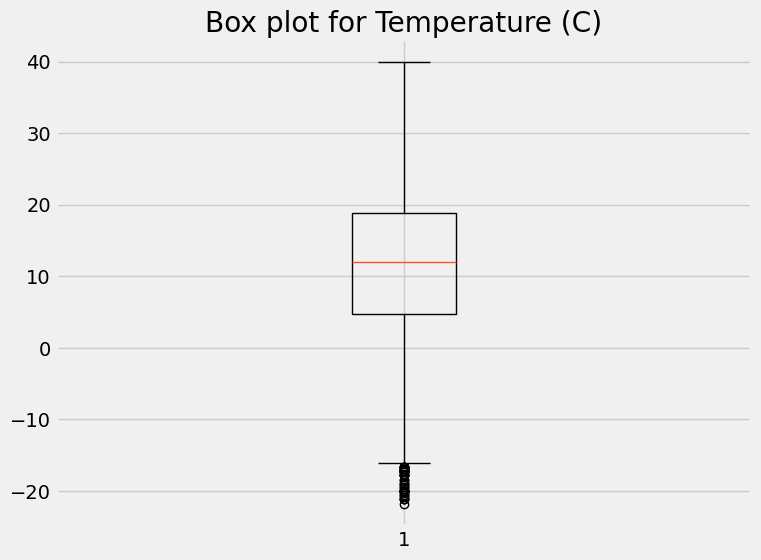

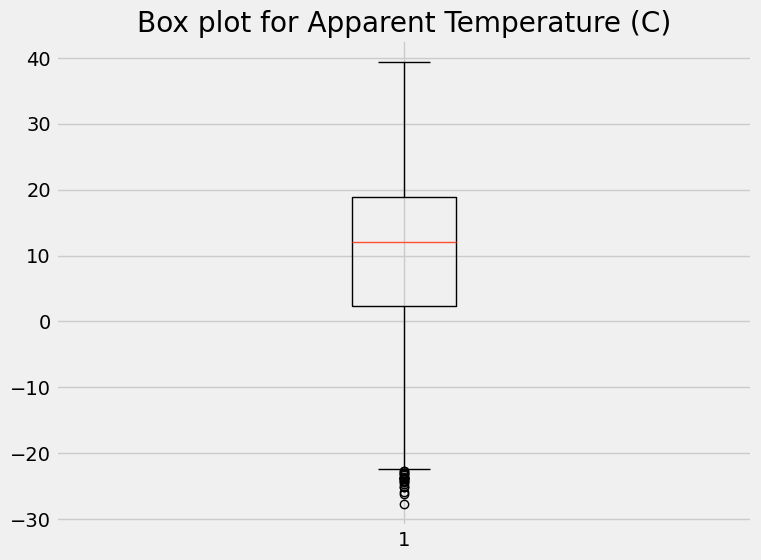

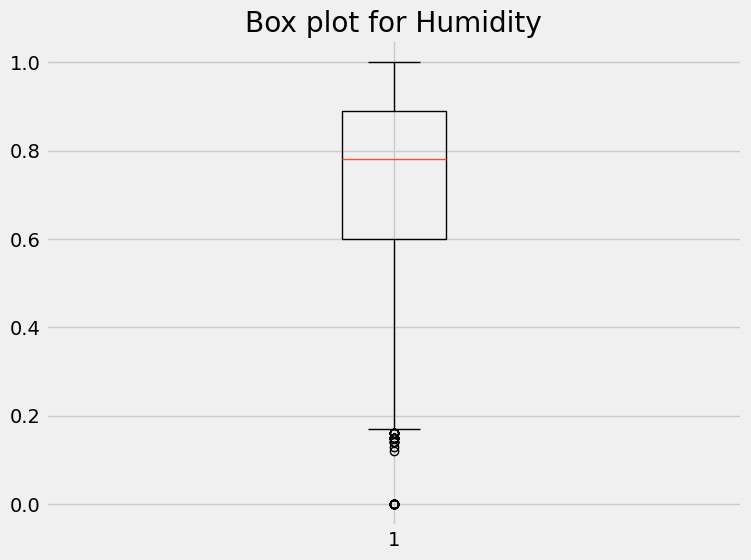

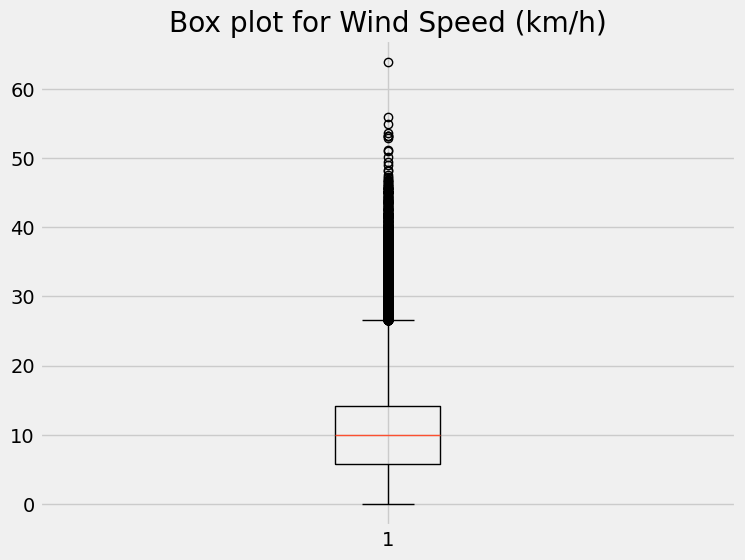

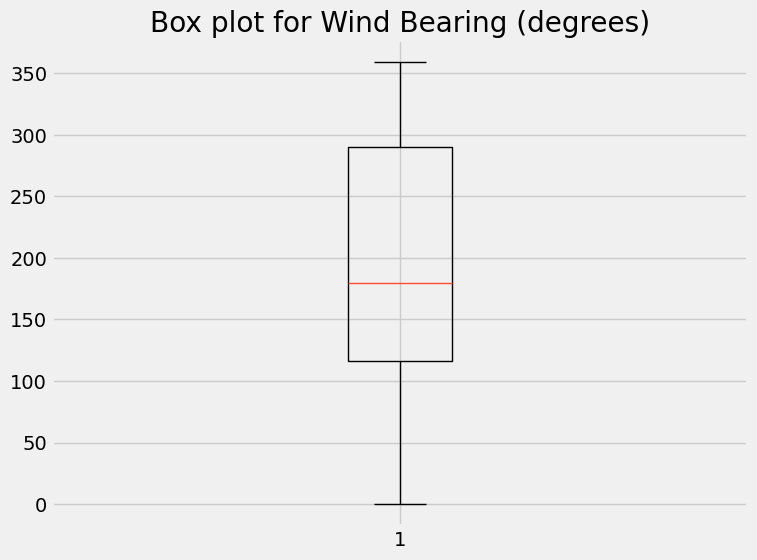

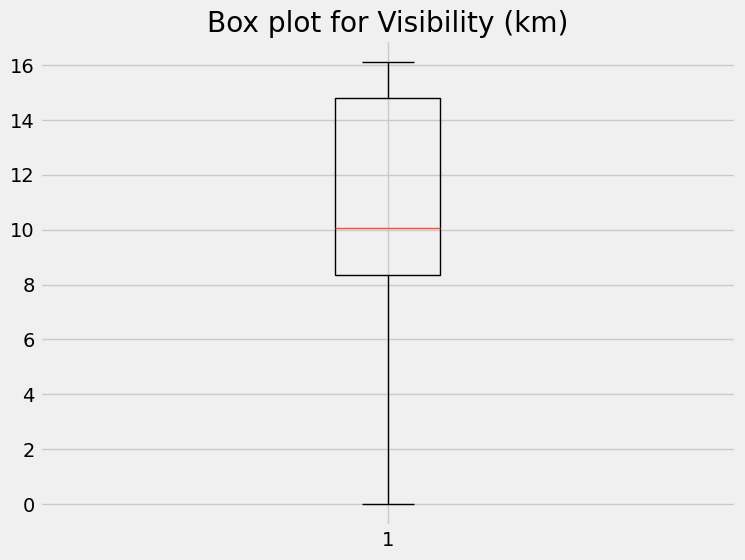

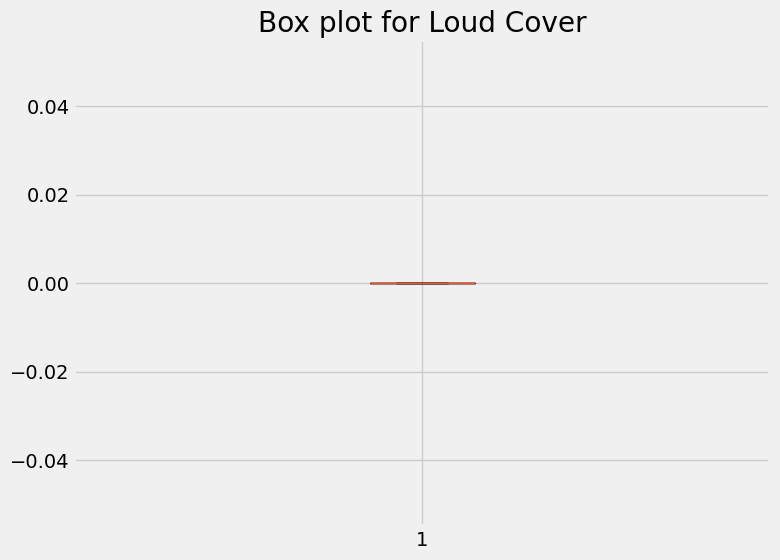

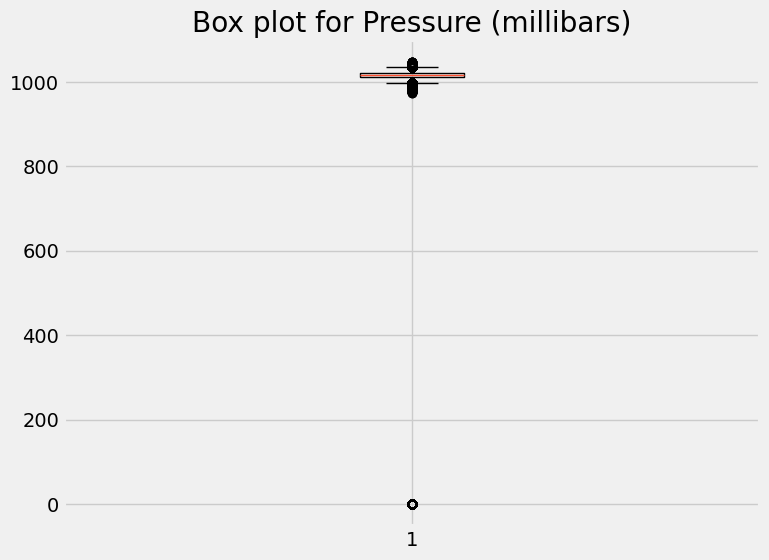

In [23]:
import matplotlib.pyplot as plt

# Assuming weather_AU is your DataFrame containing weather data

# Select numerical columns (excluding 'date' and 'weather' columns)
numeric_columns = [col for col in weather_AU.select_dtypes(include=['float64', 'int64']).columns if col not in ['date', 'weather']]

# Create box plots for each numerical column
for col in numeric_columns:
    plt.figure(figsize=(8, 6))
    plt.boxplot(weather_AU[col])
    plt.title(f'Box plot for {col}')
    plt.show()


In [24]:
# Recheck summary statistics
summary_stats = weather_AU.describe(include='all')

# Print summary statistics
print(summary_stats)


                       Formatted Date        Summary Precip Type  \
count                           96453          96453       96453   
unique                          96429             27           2   
top     2010-08-02 00:00:00.000 +0200  Partly Cloudy        rain   
freq                                2          31733       85741   
mean                              NaN            NaN         NaN   
std                               NaN            NaN         NaN   
min                               NaN            NaN         NaN   
25%                               NaN            NaN         NaN   
50%                               NaN            NaN         NaN   
75%                               NaN            NaN         NaN   
max                               NaN            NaN         NaN   

        Temperature (C)  Apparent Temperature (C)      Humidity  \
count      96453.000000              96453.000000  96453.000000   
unique              NaN                       NaN

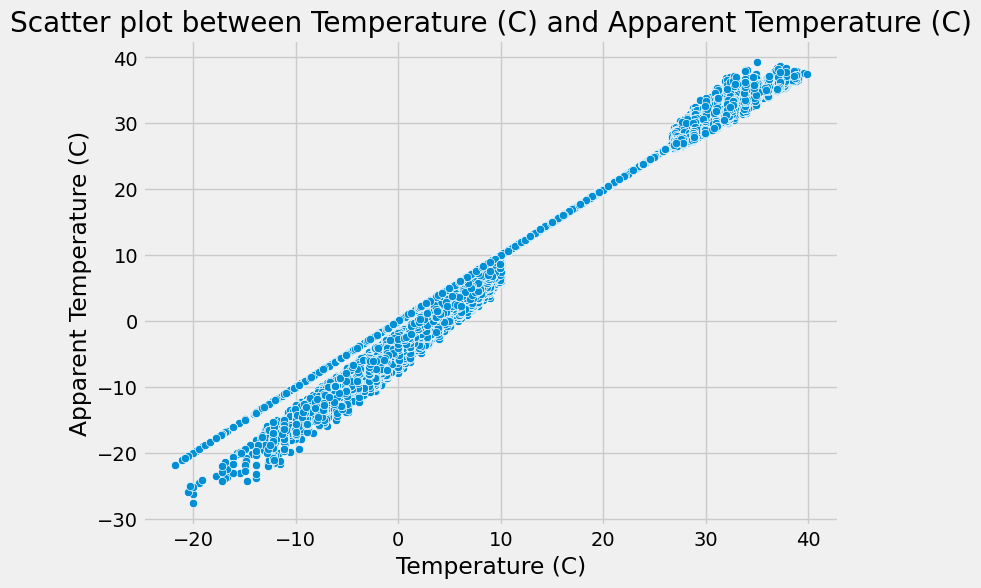

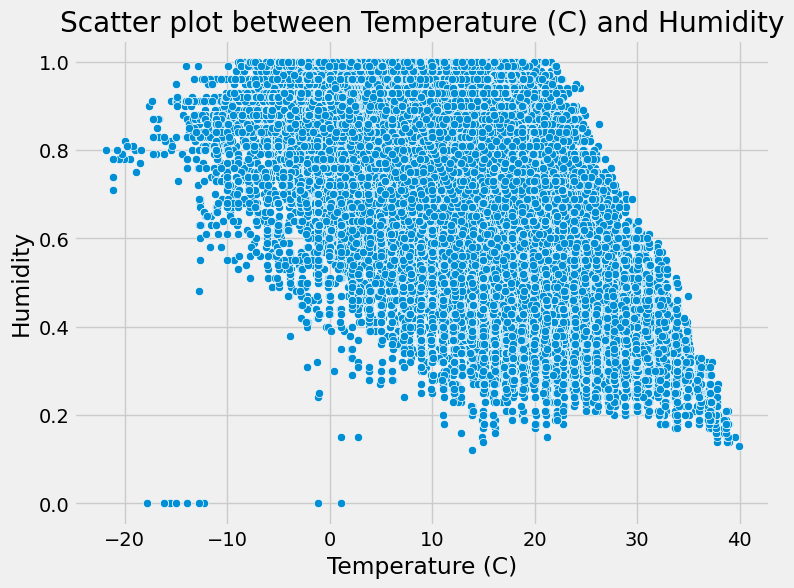

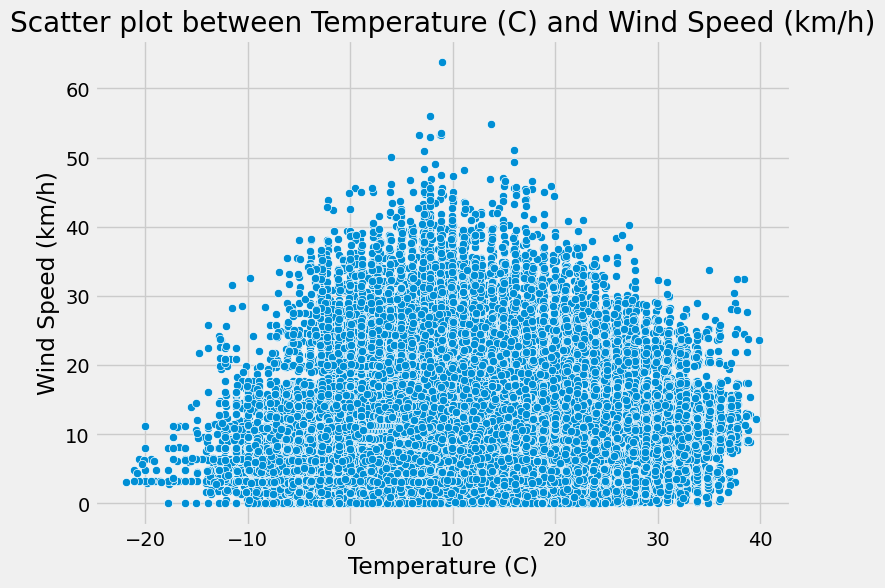

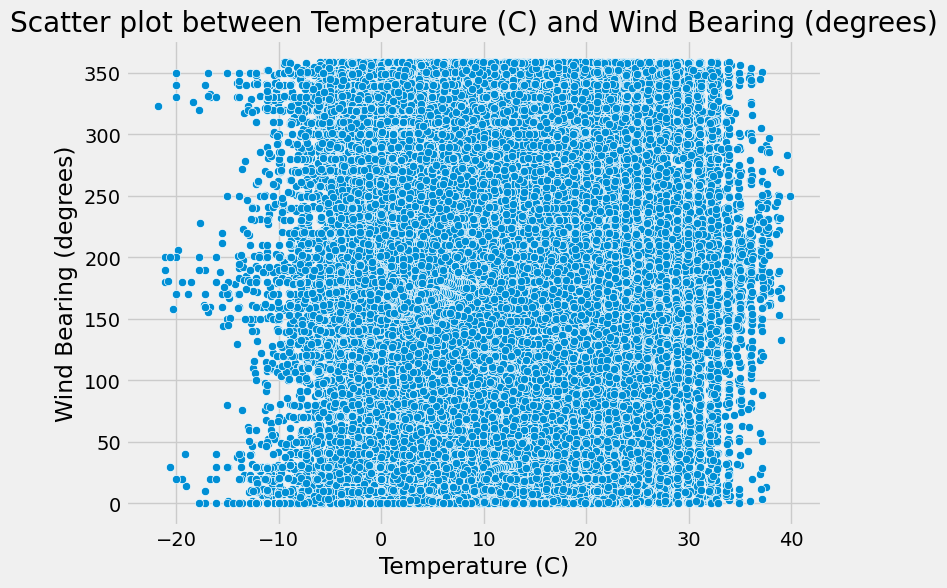

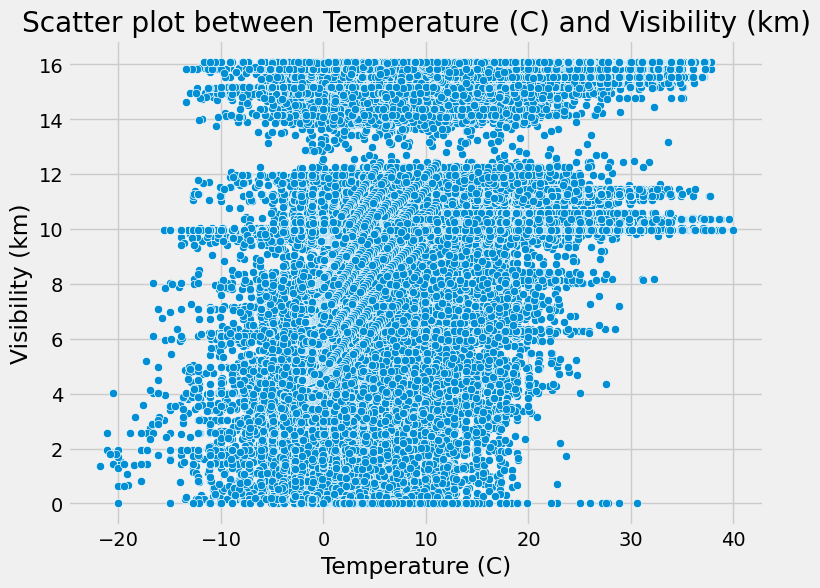

...

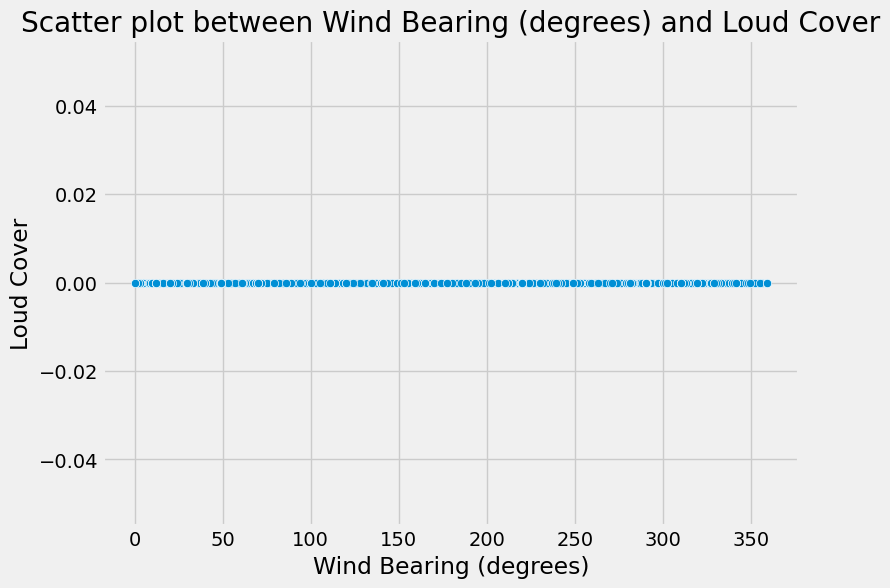

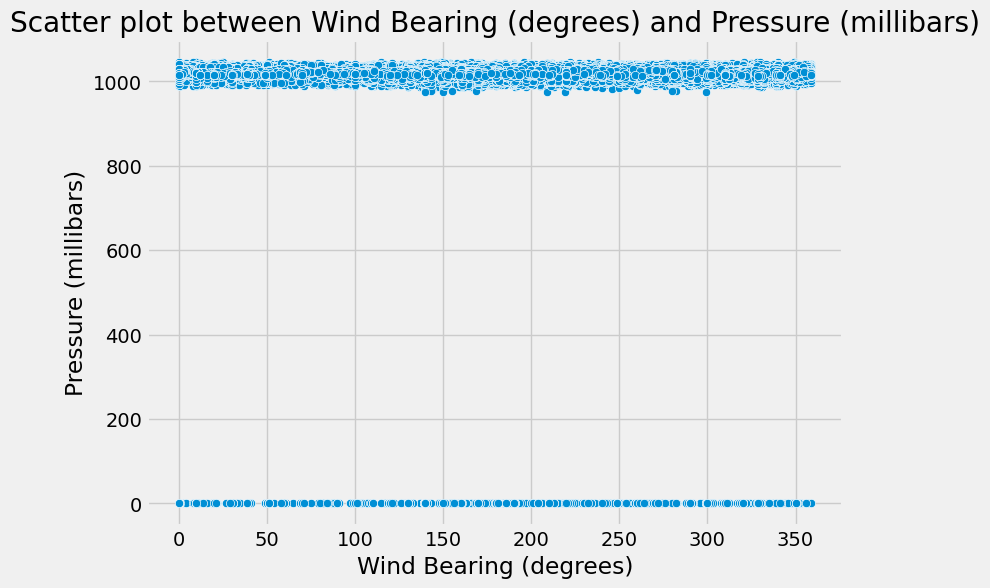

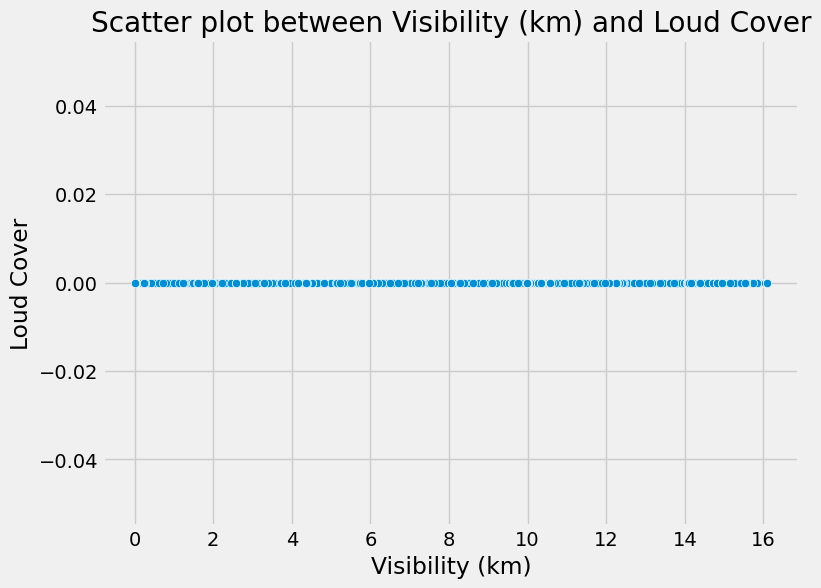

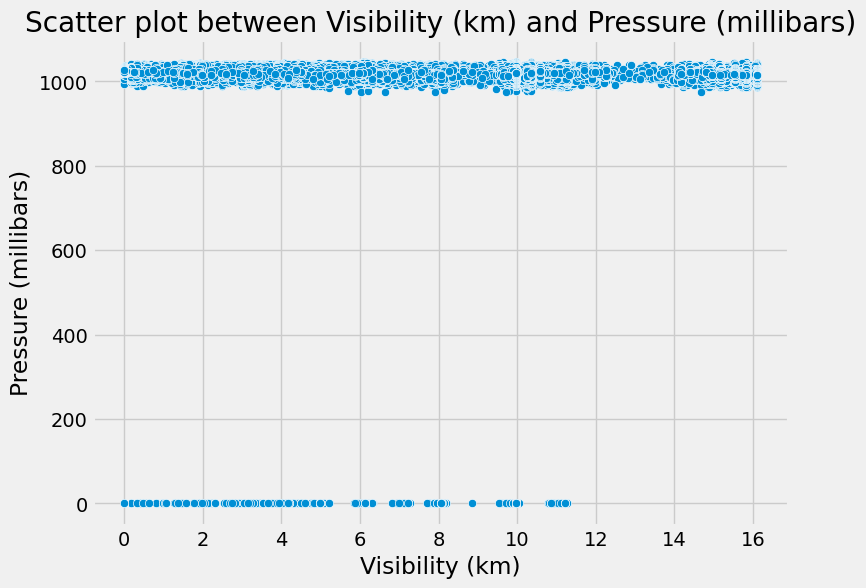

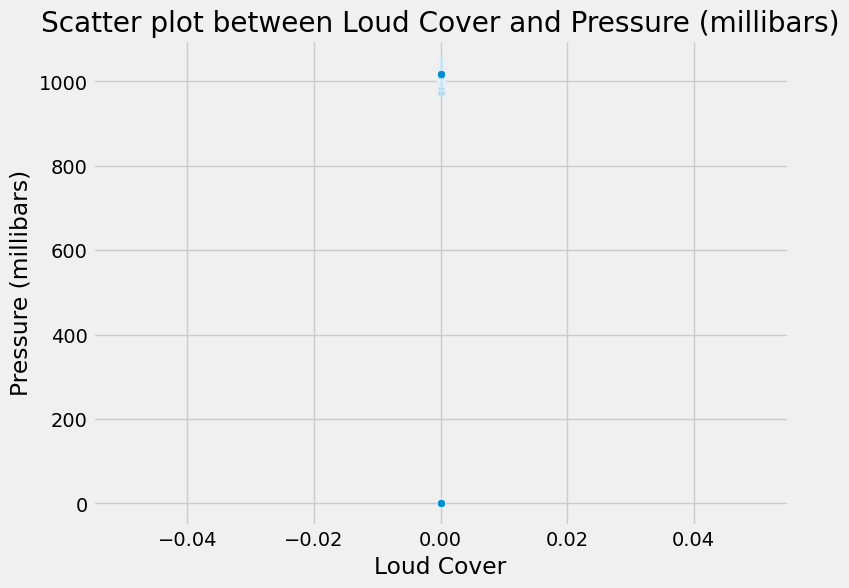

Correlation Matrix:
                          Temperature (C)  Apparent Temperature (C)  Humidity  \
Temperature (C)                  1.000000                  0.992629 -0.632255   
Apparent Temperature (C)         0.992629                  1.000000 -0.602571   
Humidity                        -0.632255                 -0.602571  1.000000   
Wind Speed (km/h)                0.008957                 -0.056650 -0.224951   
Wind Bearing (degrees)           0.029988                  0.029031  0.000735   
Visibility (km)                  0.392847                  0.381718 -0.369173   
Loud Cover                            NaN                       NaN       NaN   
Pressure (millibars)            -0.005447                 -0.000219  0.005454   

                          Wind Speed (km/h)  Wind Bearing (degrees)  \
Temperature (C)                    0.008957                0.029988   
Apparent Temperature (C)          -0.056650                0.029031   
Humidity                          -0.

In [25]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming weather_AU is your DataFrame containing weather data

# Select numerical columns (excluding 'date' and 'weather' columns)
numeric_columns = [col for col in weather_AU.select_dtypes(include=['float64', 'int64']).columns if col not in ['date', 'weather']]

# Create scatter plots for pairs of numerical columns
for i in range(len(numeric_columns)):
    for j in range(i+1, len(numeric_columns)):
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=numeric_columns[i], y=numeric_columns[j], data=weather_AU)
        plt.title(f'Scatter plot between {numeric_columns[i]} and {numeric_columns[j]}')
        plt.xlabel(numeric_columns[i])
        plt.ylabel(numeric_columns[j])
        plt.show()

# Calculate correlation coefficients
correlation_matrix = weather_AU[numeric_columns].corr()

# Print correlation matrix
print("Correlation Matrix:")
print(correlation_matrix)


In [26]:
# Select numerical columns (excluding 'date' and 'weather' columns)
numeric_columns = [col for col in weather_AU.select_dtypes(include=['float64', 'int64']).columns if col not in ['date', 'weather']]

# Calculate correlation matrix
correlation_matrix = weather_AU[numeric_columns].corr()

# Print correlation matrix
print("Correlation Matrix:")
print(correlation_matrix)


Correlation Matrix:
                          Temperature (C)  Apparent Temperature (C)  Humidity  \
Temperature (C)                  1.000000                  0.992629 -0.632255   
Apparent Temperature (C)         0.992629                  1.000000 -0.602571   
Humidity                        -0.632255                 -0.602571  1.000000   
Wind Speed (km/h)                0.008957                 -0.056650 -0.224951   
Wind Bearing (degrees)           0.029988                  0.029031  0.000735   
Visibility (km)                  0.392847                  0.381718 -0.369173   
Loud Cover                            NaN                       NaN       NaN   
Pressure (millibars)            -0.005447                 -0.000219  0.005454   

                          Wind Speed (km/h)  Wind Bearing (degrees)  \
Temperature (C)                    0.008957                0.029988   
Apparent Temperature (C)          -0.056650                0.029031   
Humidity                          -0.

In [ ]:
import pandas as pd

# Assuming 'weatherHistory.csv' is located in the root directory of your Google Drive
weather_AU = pd.read_csv('/content/drive/My Drive/weatherHistory.csv')

# Now you can proceed with splitting the dataset into training and testing sets


In [41]:
import pandas as pd
from sklearn.model_selection import train_test_split

# Define features (X) and target variable (y)
X = weather_AU[['Temperature (C)', 'Apparent Temperature (C)', 'Humidity', 'Wind Speed (km/h)', 'Wind Bearing (degrees)', 'Visibility (km)', 'Pressure (millibars)']]
y = weather_AU['Precip Type']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Print the shapes of the training and testing sets
print("X_train shape:", X_train.shape)
print("X_test shape:", X_test.shape)
print("y_train shape:", y_train.shape)
print("y_test shape:", y_test.shape)



X_train shape: (77162, 7)
X_test shape: (19291, 7)
y_train shape: (77162,)
y_test shape: (19291,)


In [49]:
print(weather_AU_encoded.columns)



Index(['Formatted Date', 'Summary', 'Precip Type', 'Temperature (C)',
       'Apparent Temperature (C)', 'Humidity', 'Wind Speed (km/h)',
       'Wind Bearing (degrees)', 'Visibility (km)', 'Loud Cover',
       'Pressure (millibars)', 'Daily Summary', 'Precip Type_snow'],
      dtype='object')


In [50]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LinearRegression

# Assuming weather_AU_encoded is your DataFrame containing weather data with encoded columns

# Define features (X) and target variable (y)
X = weather_AU_encoded[['Apparent Temperature (C)', 'Humidity', 'Wind Speed (km/h)', 'Wind Bearing (degrees)', 'Visibility (km)', 'Pressure (millibars)', 'Precip Type_snow']]
y = weather_AU_encoded['Temperature (C)']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create the multiple regression model
model = LinearRegression()

# Train the model on the training data
model.fit(X_train, y_train)


LinearRegression()

In [51]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Calculate evaluation metrics
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Mean Squared Error (MSE):", mse)
print("Mean Absolute Error (MAE):", mae)
print("R-squared (R2) Score:", r2)


Mean Squared Error (MSE): 0.8985428386217441
Mean Absolute Error (MAE): 0.7421302161978723
R-squared (R2) Score: 0.990250109531251


In [53]:
# Suppose you have new data stored in a DataFrame called 'new_data'
# Define features for the new data
X_new = X_test.sample(n=5, random_state=42)  # Example: Using a sample from the test data for demonstration

# Make predictions on the new data
y_pred_new = model.predict(X_new)

# Display the predictions
print("Predictions on new data:")
print(y_pred_new)


Predictions on new data:
[17.40752455  1.51360477 19.27155556 14.52865602  6.9766305 ]


In [54]:
from sklearn.metrics import mean_squared_error, r2_score

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)

# Calculate R-squared (R2) Score
r2 = r2_score(y_test, y_pred)

# Print the model accuracy metrics
print("Mean Squared Error (MSE) before feature selection:", mse)
print("R-squared (R2) Score before feature selection:", r2)


Mean Squared Error (MSE) before feature selection: 0.8985428386217441
R-squared (R2) Score before feature selection: 0.990250109531251


In [56]:
from sklearn.feature_selection import SelectKBest, f_regression

# Initialize SelectKBest with the desired number of features (k)
selector = SelectKBest(score_func=f_regression, k=5)  # Example: Selecting top 5 features using f_regression score

# Fit selector to training data and transform the data to select the top k features
X_train_selected = selector.fit_transform(X_train, y_train)

# Transform the testing data using the fitted selector to keep only the selected features
X_test_selected = selector.transform(X_test)

# Get the selected feature indices
selected_feature_indices = selector.get_support(indices=True)

# Get the names of selected features
selected_feature_names = X.columns[selected_feature_indices]

print("Selected features:", selected_feature_names)


Selected features: Index(['Apparent Temperature (C)', 'Humidity', 'Wind Bearing (degrees)',
       'Visibility (km)', 'Precip Type_snow'],
      dtype='object')


In [57]:
from sklearn.metrics import mean_squared_error, r2_score

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_pred)

# Calculate R-squared (R2) Score
r2 = r2_score(y_test, y_pred)

# Print the model accuracy metrics
print("Mean Squared Error (MSE) before feature selection:", mse)
print("R-squared (R2) Score before feature selection:", r2)


Mean Squared Error (MSE) before feature selection: 0.8985428386217441
R-squared (R2) Score before feature selection: 0.990250109531251


In [61]:
# Assuming X_test_selected contains only the selected features after feature selection
# If X_test_selected has fewer features than the original dataset, you can filter the original testing data

# Filter the columns of the original testing data based on the selected features
X_test_selected = X_test[['Apparent Temperature (C)', 'Humidity', 'Wind Speed (km/h)', 'Wind Bearing (degrees)', 'Visibility (km)', 'Pressure (millibars)', 'Precip Type_snow']]

# Make predictions on the updated testing set with selected features
y_pred_selected = model.predict(X_test_selected)

# Calculate Mean Squared Error (MSE) after feature selection
mse_selected = mean_squared_error(y_test, y_pred_selected)

# Calculate R-squared (R2) Score after feature selection
r2_selected = r2_score(y_test, y_pred_selected)

# Print the model accuracy metrics after feature selection
print("Mean Squared Error (MSE) after feature selection:", mse_selected)
print("R-squared (R2) Score after feature selection:", r2_selected)


Mean Squared Error (MSE) after feature selection: 0.8985428386217441
R-squared (R2) Score after feature selection: 0.990250109531251


In [63]:
import joblib

# Assuming 'model' is your trained model object
# Save the model to a file
joblib.dump(model, '/content/drive/My Drive/AlphyModelling-And-Simulation')


['/content/drive/My Drive/AlphyModelling-And-Simulation']